# Import Packages

In [2]:
%load_ext autoreload
%autoreload 2
import glob
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import folium
import geopandas
import geopy
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.diagnostic import linear_rainbow, het_breuschpagan
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error, make_scorer
from geopy.geocoders import Nominatim
from geopy.extra.rate_limiter import RateLimiter
import folium.plugins as plugins
import math
from math import sin, cos, sqrt, atan2, radians
from haversine import haversine
from itertools import combinations
%matplotlib inline
pd.set_option("display.max_columns", 200)
pd.set_option("display.max_rows", 200)
import sys
import os
path_to_src = os.path.join('..\..', 'src')
sys.path.insert(0, path_to_src)
from useful_functions import *


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Read in the data  

In [3]:
files = glob.glob("..\..\data/raw/provided/*.csv")
names = ['lookup', 'parcel', 'resbldg', 'rpsale']
dict_dfs = {}
for x,y in zip(names, files):
    dict_dfs[x] = pd.read_csv(y, dtype=str)
lookup_df = dict_dfs['lookup']
parcel_df = dict_dfs['parcel']
resbldg_df = dict_dfs['resbldg']
rpsale_df = dict_dfs['rpsale']

First with an explore of the dataframes one by one and see which columns could potentially be dropped, important to remember this project is going to be focussed on home improvements. For that reason it will be important to keep any columns that could pertain to home improvements, but in order to make the conclusions reached as accurate as possible, it may be necessary to keep some columns not related to home improvements in order to improve the overall accuracy of the model i.e Zip code.

In [4]:
parcel_df.head()

,Unnamed: 0,Major,Minor,PropName,PlatName,PlatLot,PlatBlock,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems
0,0,807841,0410,,SUMMER RIDGE DIV NO. 02,41,,6,25,22,SW,R,35,2,NaN,NaN,SAMMAMISH,2187,R4,1,1,2,7424,2,2,4,0,1,0,0,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N
1,2,755080,0015,,SANDER'S TO GILMAN PK & SALMON BAY,3,1,3,25,11,NW,R,19,1,NaN,NaN,SEATTLE,0010,SF 5000,1,1,2,5000,2,2,4,0,1,0,0,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N
2,3,888600,0135,,VASHON GARDENS ADD,21,,3,22,8,NE,R,100,3,NaN,NaN,KING COUNTY,4055,RA5,1,1,2,277041,2,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N
3,6,022603,9181,,NaN,,,3,26,2,NW,R,1,1,NaN,NaN,SHORELINE,2263,R6,1,1,2,10560,2,2,4,0,1,0,0,0,False,0,2,0,2,0,2,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N
4,7,229670,0160,,ELDORADO NORTH,16,,5,26,19,SW,R,37,2,NaN,NaN,KIRKLAND,1708,RSA 6,1,1,2,9853,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N


In [5]:
resbldg_df.head()

,Major,Minor,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost
0,009800,0720,1,1,27719 SE 26TH WAY 98075,27719,,SE,26TH,WAY,,98075,2,11,0,1970,0,2130,0,0,0,4100,0,0,0,0,750,,0,0,0,5,2,0,,4,1,0,3,3,0,0,0,2001,0,0,0,0,3,0
1,009802,0140,1,1,2829 277TH TER SE 98075,2829,,,277TH,TER,SE,98075,2,10,0,1610,0,1400,0,0,0,3010,0,0,0,0,660,,380,0,0,5,2,0,,4,1,2,2,3,0,0,0,2004,0,0,0,0,3,0
2,009830,0020,1,1,1715 298TH CRESENT SE,1715,,,298TH CRESENT,,SE,NaN,2,10,0,2520,0,2560,0,0,0,5080,0,0,0,0,1020,,360,0,270,5,2,0,,4,0,0,5,1,0,0,0,2017,0,0,0,0,3,0
3,009830,0160,1,1,1861 297TH WAY SE 98024,1861,,,297TH,WAY,SE,98024,2,10,0,2210,0,1860,0,0,0,4070,0,0,0,0,1000,N,690,0,0,5,2,0,N,4,1,0,3,2,0,0,0,2013,0,0,0,0,3,0
4,010050,0180,1,1,35410 25TH PL S 98003,35410,,,25TH,PL,S,98003,2,7,0,910,0,700,0,0,0,1610,0,0,0,0,440,,60,0,0,5,2,0,,3,1,1,1,1,0,0,0,1994,0,0,0,0,4,0


In [6]:
rpsale_df.head()

,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot,PlatBlock,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning
0,2857854,198920,1430,03/28/2017,0,20170410000541,,,,,,,AD APARTMENTS LLC ...,SEATTLE CITY OF ...,3,7,15,N,N,N,N,16,2,20 31
1,2743355,638580,0110,07/14/2015,190000,20150715002686,,,,,,,GINGRICH AUDREY B ...,NATION FRED I ...,3,6,3,N,N,N,N,1,8,15
2,2999169,919715,0200,07/08/2019,192000,20190712001080,,,,,,,WAGNERESTATES LLC ...,SCHAFFER CORBIN ...,3,2,3,N,N,N,N,1,3,
3,2841697,894677,0240,12/21/2016,818161,20161228000896,,,,,,,QUADRANT CORPORATION ...,KANG JING ...,2,6,3,N,N,N,N,1,8,
4,2826129,445872,0260,10/03/2016,0,20161004000511,,,,,,,MARCH CARL J + SUSAN A ...,MARCH CARL J + SUSAN A REVOCABLE LIVING TRUST ...,3,2,15,N,N,N,N,18,3,18 31


In [7]:
lookup_df.head()

,LUType,LUItem,LUDescription
0,1,1,LAND ONLY ...
1,1,10,Land with new building ...
2,1,11,"Household, single family units ..."
3,1,12,"Multiple family residence (Residential, 2-4 un..."
4,1,13,"Multiple family residence (Residential, 5+ uni..."


Looks like it will be possible to merge the first 3 dataframes on Major and Minor. The last dataframe is a look up table which contains important information pertaining to various features of the properties.

For each dataframe I will combine the Major and Minor columns, creating an 'id' column, I will then merge the dataframes on this.

In [8]:
for df in [parcel_df, resbldg_df, rpsale_df]:
    concat_col(df, 'id', 'Major', 'Minor')

Ensure this has worked successfully, print the first 3 entries for each df.

In [9]:
for df in [parcel_df, resbldg_df, rpsale_df]:
    print(df[['Major', 'Minor', 'id']][:3])

    Major Minor          id
0  807841  0410  8078410410
1  755080  0015  7550800015
2  888600  0135  8886000135
    Major Minor          id
0  009800  0720  0098000720
1  009802  0140  0098020140
2  009830  0020  0098300020
    Major Minor          id
0  198920  1430  1989201430
1  638580  0110  6385800110
2  919715  0200  9197150200


Time to merge the dataframes and start cleaning it as a whole

In [10]:
merge_df = resbldg_df.merge(parcel_df, on='id', how='inner')
total_df = merge_df.merge(rpsale_df, how='left', on='id')

Time to explore the merged dataframe

In [11]:
total_df.shape

(251300, 157)

A lot of data! Hopefully some of these rows and columns can be cut down. First, remembering the brief of this project was to use data from 2019 to inform clients of home improvements. I will cut out any house sale that isn't from 2019.

In [12]:
total_df.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning
0,009800,0720,1,1,27719 SE 26TH WAY 98075,27719,,SE,26TH,WAY,,98075,2,11,0,1970,0,2130,0,0,0,4100,0,0,0,0,750,,0,0,0,5,2,0,,4,1,0,3,3,0,0,0,2001,0,0,0,0,3,0,0098000720,71581,009800,0720,,ALDARRA DIV NO. 01,72,,7,24,7,NW,R,69,6,NaN,NaN,SAMMAMISH,2198,R1,1,1,2,16647,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,1,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,2936583,009800,0720,06/14/2018,1300000,20180618000684,,,,,,,AYRES DOUGLAS W ...,HIGGIE JOHN ...,11,6,3,N,N,N,N,1,8,
1,009802,0140,1,1,2829 277TH TER SE 98075,2829,,,277TH,TER,SE,98075,2,10,0,1610,0,1400,0,0,0,3010,0,0,0,0,660,,380,0,0,5,2,0,,4,1,2,2,3,0,0,0,2004,0,0,0,0,3,0,0098020140,68023,009802,0140,,ALDARRA DIV NO 03,14,,7,24,7,NW,R,69,6,NaN,NaN,SAMMAMISH,2198,R1,1,1,2,7221,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3046924,009802,0140,04/17/2020,0,20200515000525,,,,,,,HOVIS WILLIAM ...,HOVIS WILLIAM+HOVIS REVOCABLE LIVING TRUST WIL...,11,6,15,N,N,N,N,18,8,
2,009802,0140,1,1,2829 277TH TER SE 98075,2829,,,277TH,TER,SE,98075,2,10,0,1610,0,1400,0,0,0,3010,0,0,0,0,660,,380,0,0,5,2,0,,4,1,2,2,3,0,0,0,2004,0,0,0,0,3,0,0098020140,68023,009802,0140,,ALDARRA DIV NO 03,14,,7,24,7,NW,R,69,6,NaN,NaN,SAMMAMISH,2198,R1,1,1,2,7221,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3046923,009802,0140,04/17/2020,0,20200515000524,,,,,,,HOVIS WILLIAM+LAURIE ...,HOVIS WILLIAM ...,11,6,15,N,N,N,N,18,8,
3,009802,0140,1,1,2829 277TH TER SE 98075,2829,,,277TH,TER,SE,98075,2,10,0,1610,0,1400,0,0,0,3010,0,0,0,0,660,,380,0,0,5,2,0,,4,1,2,2,3,0,0,0,2004,0,0,0,0,3,0,0098020140,68023,009802,0140,,ALDARRA DIV NO 03,14,,7,24,7,NW,R,69,6,NaN,NaN,SAMMAMISH,2198,R1,1,1,2,7221,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3046922,009802,0140,04/17/2020,0,20200515000523,,,,,,,HOVI

In [13]:
total_df['Date'] = pd.to_datetime(total_df['DocumentDate'], format='%m/%d/%Y')
total_df['Date'] = pd.DatetimeIndex(total_df['Date']).year
total_df = total_df[total_df['Date']==2019]

In [14]:
total_df.shape

(43838, 158)

Ok number of rows has been drastically reduced from ~251k to ~44k. Next I will filter out by property type, I want to focus on households. Using the look up table information, I know that property type 11 is household, single family unit. Property type 12 may be of interest too but depends on numbers.

In [15]:
total_df.PropertyType.value_counts()

11    26510
3     13186
2      1612
10     1338
0       322
12      286
1       256
14      137
91       61
5        32
18       23
45       16
13       13
4        12
83        8
59        5
96        4
99        3
6         3
19        3
65        2
94        2
15        1
86        1
23        1
51        1
Name: PropertyType, dtype: int64

In [16]:
for col in lookup_df.columns[:-1]:
    lookup_df[col] = lookup_df[col].str.strip().astype(int)
lookup(lookup_df, 1)

,LUType,LUItem,LUDescription
0,1,1,LAND ONLY ...
1,1,10,Land with new building ...
2,1,11,"Household, single family units ..."
3,1,12,"Multiple family residence (Residential, 2-4 un..."
4,1,13,"Multiple family residence (Residential, 5+ uni..."
5,1,14,Residential condominiums ...
6,1,15,Mobile home parks or courts ...
7,1,16,Hotels/motels ...
8,1,17,Institutional lodging ...
9,1,18,All other residential not elsewhere coded ...


Considering the overwhelming number of homes are type 11, the next two most populous categories refer to land sales. It makes sense to therefore restrict this analysis to property type 11.

In [17]:
total_df = total_df[total_df['PropertyType']=='11']

In [18]:
list(total_df.columns)

['Major_x',
 'Minor_x',
 'BldgNbr',
 'NbrLivingUnits',
 'Address',
 'BuildingNumber',
 'Fraction',
 'DirectionPrefix',
 'StreetName',
 'StreetType',
 'DirectionSuffix',
 'ZipCode',
 'Stories',
 'BldgGrade',
 'BldgGradeVar',
 'SqFt1stFloor',
 'SqFtHalfFloor',
 'SqFt2ndFloor',
 'SqFtUpperFloor',
 'SqFtUnfinFull',
 'SqFtUnfinHalf',
 'SqFtTotLiving',
 'SqFtTotBasement',
 'SqFtFinBasement',
 'FinBasementGrade',
 'SqFtGarageBasement',
 'SqFtGarageAttached',
 'DaylightBasement',
 'SqFtOpenPorch',
 'SqFtEnclosedPorch',
 'SqFtDeck',
 'HeatSystem',
 'HeatSource',
 'BrickStone',
 'ViewUtilization',
 'Bedrooms',
 'BathHalfCount',
 'Bath3qtrCount',
 'BathFullCount',
 'FpSingleStory',
 'FpMultiStory',
 'FpFreestanding',
 'FpAdditional',
 'YrBuilt',
 'YrRenovated',
 'PcntComplete',
 'Obsolescence',
 'PcntNetCondition',
 'Condition',
 'AddnlCost',
 'id',
 'Unnamed: 0',
 'Major_y',
 'Minor_y',
 'PropName',
 'PlatName',
 'PlatLot_x',
 'PlatBlock_x',
 'Range',
 'Township',
 'Section',
 'QuarterSection',


Ok, need to make this more useable, drop columns that will no longer be required.

Now I want to create an address column which can be used directly to find latitude and longitude of the property. The current Address column will not work with zip.

In [19]:
street_types = {'AVE': 'avenue', 'ST': 'street', 'PL': 'place', 'CT': 'court',\
                'DR': 'drive', 'LN': 'lane', 'RD':'road', 'BLVD': 'boulevard', 'PKWY': 'parkway',\
                'TER':'terrace', 'CRES': 'cresent', 'KY':'KY', 'WALK':'WALK'}

In [20]:
total_df.StreetType.str.strip().map(street_types)

10           street
11           street
17           avenue
21        boulevard
28           avenue
            ...    
251231       street
251258       avenue
251269        place
251295       street
251296       street
Name: StreetType, Length: 26510, dtype: object

In [21]:
total_df['address'] = total_df['BuildingNumber'].str.strip() + ' '+ total_df['DirectionPrefix'].str.strip()+' '\
                            + total_df['StreetName'].str.strip() + ' ' + total_df['StreetType']\
                            + ' ' + total_df['DirectionSuffix'].str.strip() + ',' + ' ' + total_df['DistrictName'].str.strip()\
                            + ', WA' + ', USA'

In [22]:
total_df.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning,Date,address
10,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,ST,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3025506,010050,0380,12/12/2019,445000,20191213001173,,,,,,,VOVK CONSTRUCTION INC. ...,CENIDO AZHJELI ...,11,6,3,N,N,N,N,1,8,,2019,"2435 S 354TH ST , KING COUNTY, WA, USA"
11,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,ST,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3005732,010050,0380,08/16/2019,311000,20190819001381,,,,,,,GRAY DEANNA ...,VOVK CONSTRUCTION INC ...,11,6,3,N,N,N,N,1,8,26,2019,"2435 S 354TH ST , KING COUNTY, WA, USA"
17,017900,0315,1,1,12254 43RD AVE S 98178,12254,,,43RD,AVE,S,98178,1,5,0,550,0,0,0,0,0,550,0,0,0,0,0,,0,0,0,1,1,0,,2,0,1,0,0,0,0,0,1942,0,0,0,0,3,0,0179000315,315201,017900,0315,,ALLENTOWN ADD,18,2,4,23,10,SE,R,24,5,NaN,NaN,TUKWILA,2408,LDR,1,1,2,4000,2,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3024301,017900,0315,12/05/2019,188500,20191206000920,,,,,,,GEARHART PHILLIP E+CHARLENE L ...,KELLER ROBERT T ...,11,6,3,N,N,N,N,1,8,,2019,"12254 43RD AVE S, TUKWILA, WA, USA"
21,018800,0095,1,1,1602 LAKEVIEW BLVD E 98102,1602,,,LAKEVIEW,BLVD,E,98102,2,9,0,660,0,595,0,0,0,1540,380,285,8,0,0,Y,0,0,155,1,3,0,Y,3,1,1,1,0,1,0,0,1984,0,0,0,0,3,0,0188000095,245005,018800,0095,Half of Duplex,ALLMOND ADD REPLAT,7,2,4,25,20,SE,R,13,3,NaN,NaN,SEATTLE,0010,LR2 (M),1,1,29,3117,2,2,4,1,1,0,0,0,False,0,0,0,0,0

time to check for duplicates, check how many are duplicated on sale price and id.

In [23]:
total_df.duplicated(subset=['SalePrice','id'], keep='last').sum()

1008

remove duplicates on Sale Price and id.

In [24]:
total_df.drop_duplicates(subset=['SalePrice','id'], keep='last', inplace=True)

Lets investigate the values in each column, this might aid me in deciding which ones to drop

In [25]:
for col in total_df.columns:
    print(col)
    print(total_df[col].value_counts())

Major_x
276760    90
762570    68
814136    63
510140    60
277060    57
          ..
107000     1
370890     1
715620     1
383060     1
082204     1
Name: Major_x, Length: 7494, dtype: int64
Minor_x
0040    484
0030    471
0020    438
0010    408
0060    407
       ... 
2231      1
4210      1
1132      1
1862      1
2076      1
Name: Minor_x, Length: 2751, dtype: int64
BldgNbr
1    25390
2      107
3        3
7        1
4        1
Name: BldgNbr, dtype: int64
NbrLivingUnits
1    25263
2      197
3       42
Name: NbrLivingUnits, dtype: int64
Address
                              18
18203  SE 272ND ST   98042     4
15425   2ND AVE NE  98155      4
7932   28TH AVE SW  98126      3
1215  NW 95TH ST   98117       3
                              ..
519  S 214TH ST   98198        1
1541   GRAND AVE   98122       1
1154   57TH DR SE  98092       1
3704  NE 9TH CT   98056        1
16312   MAIN VIEW LN NE        1
Name: Address, Length: 24447, dtype: int64
BuildingNumber
         22
411      2

1300    174
1250    166
1560    160
1800    160
1780    151
       ... 
3465      1
3058      1
3596      1
5620      1
2076      1
Name: SqFtTotLiving, Length: 1278, dtype: int64
SqFtTotBasement
0       12957
1010      229
1100      197
1060      197
1200      192
        ...  
1101        1
1578        1
786         1
1038        1
5060        1
Name: SqFtTotBasement, Length: 440, dtype: int64
SqFtFinBasement
0       15077
500       279
800       219
600       216
400       212
        ...  
383         1
2500        1
825         1
2620        1
766         1
Name: SqFtFinBasement, Length: 388, dtype: int64
FinBasementGrade
0     15077
7      4084
6      2372
8      2249
9       801
5       442
10      257
11      119
4        57
12       20
3        16
13        6
2         1
20        1
Name: FinBasementGrade, dtype: int64
SqFtGarageBasement
0       20020
200       351
240       274
220       221
290       200
480       188
260       184
310       172
400       149
340       128
4

Name: YrBuilt, dtype: int64
YrRenovated
0       24209
2018       98
2019       92
2003       52
2000       43
1990       38
2016       38
2007       35
2006       35
2005       34
2004       33
2013       33
2010       31
2014       31
1996       30
2002       30
2012       29
2017       29
1995       27
2008       27
1993       26
2015       26
1998       24
1991       24
1992       22
1983       22
2009       20
1997       19
2001       18
1994       18
1989       18
1988       17
1999       16
1987       15
1986       15
1978       13
2011       13
1960       12
1965       11
1984       11
1980       11
1977       10
1982        9
1985        9
1956        8
1968        8
2020        7
1973        7
1963        7
1961        7
1970        6
1979        6
1974        5
1954        5
1967        5
1969        4
1955        4
1976        4
1949        4
1962        4
1981        4
1959        4
1958        3
1945        3
1966        3
1971        3
1957        2
1950        2
1953    

Name: PresentUse, dtype: int64
SqFtLot
5000     407
6000     354
4000     321
7200     319
8400     136
        ... 
7088       1
4987       1
1962       1
10391      1
25616      1
Name: SqFtLot, Length: 10803, dtype: int64
WaterSystem
2    24767
1      722
4        7
0        6
Name: WaterSystem, dtype: int64
SewerSystem
2    21817
1     3669
0       11
3        3
4        2
Name: SewerSystem, dtype: int64
Access
4    23841
3     1602
1       25
5       22
0       10
2        2
Name: Access, dtype: int64
Topography
0    23362
1     2140
Name: Topography, dtype: int64
StreetSurface
1    24595
2      668
0      218
3       17
4        4
Name: StreetSurface, dtype: int64
RestrictiveSzShape
0    25405
1       97
Name: RestrictiveSzShape, dtype: int64
InadequateParking
2    15861
0     9619
1       22
Name: InadequateParking, dtype: int64
PcntUnusable
0     25494
34        1
30        1
3         1
12        1
26        1
19        1
23        1
36        1
Name: PcntUnusable, dtype: int6

QUALITY LOAN SERVICE CORPORATION OF WA                44
QUADRANT CORPORATION                                  41
LGI HOMES-WASHINGTON LLC                              40
FLYHOMES INVESTMENTS WA LLC                           29
MRN HOMES LLC                                         29
                                                      ..
TIAN LEI                                               1
MCKINNEY STEVEN                                        1
ROSEWARNE HEATHER C+WILLIAM M                          1
POST DAVID+LAURIE L                                    1
LOCUS INVESTMENTS LLC                                  1
Name: SellerName, Length: 23975, dtype: int64
BuyerName
FLYHOMES INVESTMENTS WA LLC                           45
HPA US1 LLC                                           30
MUIR RESIDENTIAL INVESTMENTS LLC                      20
NATIONAL RESIDENTIAL NOMINEE SERVICES INC             17
IH6 PROPERTY WASHINGTON LP                            15
                                

In [26]:
total_df['SalePrice'] = total_df['SalePrice'].astype(int)

In [27]:
def show_box(df, col):
    return sns.boxplot(x=col, y="SalePrice", data=df, showfliers=False)

<AxesSubplot:xlabel='Easements', ylabel='SalePrice'>

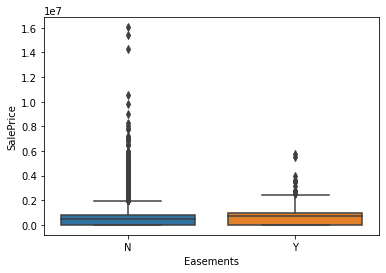

In [28]:
sns.boxplot(x='Easements', y="SalePrice", data=total_df, showfliers=True)

In [29]:
len(total_df)

25502

In [30]:
total_df.PropertyType.value_counts()

11    25502
Name: PropertyType, dtype: int64

In [31]:
total_df = total_df[total_df['SalePrice']!=0]

In [32]:
from geopy.geocoders import Nominatim
locator = Nominatim(user_agent='myGeocoder')
location = locator.geocode('2435  S  354TH                     ST       , KING COUNTY, WA, USA')
print('Latitude = {}, Longitude = {}'.format(location.latitude, location.longitude))

Latitude = 47.28493, Longitude = -122.30216590825634


In [33]:
# # 1 - conveneint function to delay between geocoding calls
# geocode = RateLimiter(locator.geocode, min_delay_seconds=1)
# # 2- - create location column
# total_df['location'] = total_df['address'].apply(geocode)
# # 3 - create longitude, laatitude and altitude from location column (returns tuple)
# total_df['point'] = total_df['location'].apply(lambda loc: tuple(loc.point)\
#                                                              if loc else None)
# # 4 - split point column into latitude, longitude and altitude columns
# total_df[['latitude', 'longitude', 'altitude']] = pd.DataFrame(total_df['point'].\
#                                                                       tolist(), index=total_df.\
#                                                                       index)

In [34]:
total_df.head()

,Major_x,Minor_x,BldgNbr,NbrLivingUnits,Address,BuildingNumber,Fraction,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,BldgGradeVar,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtUnfinFull,SqFtUnfinHalf,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,FpSingleStory,FpMultiStory,FpFreestanding,FpAdditional,YrBuilt,YrRenovated,PcntComplete,Obsolescence,PcntNetCondition,Condition,AddnlCost,id,Unnamed: 0,Major_y,Minor_y,PropName,PlatName,PlatLot_x,PlatBlock_x,Range,Township,Section,QuarterSection,PropType,Area,SubArea,SpecArea,SpecSubArea,DistrictName,LevyCode,CurrentZoning,HBUAsIfVacant,HBUAsImproved,PresentUse,SqFtLot,WaterSystem,SewerSystem,Access,Topography,StreetSurface,RestrictiveSzShape,InadequateParking,PcntUnusable,Unbuildable,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,WfntBank,WfntPoorQuality,WfntRestrictedAccess,WfntAccessRights,WfntProximityInfluence,TidelandShoreland,LotDepthFactor,TrafficNoise,AirportNoise,PowerLines,OtherNuisances,NbrBldgSites,Contamination,DNRLease,AdjacentGolfFairway,AdjacentGreenbelt,HistoricSite,CurrentUseDesignation,NativeGrowthProtEsmt,Easements,OtherDesignation,DeedRestrictions,DevelopmentRightsPurch,CoalMineHazard,CriticalDrainage,ErosionHazard,LandfillBuffer,HundredYrFloodPlain,SeismicHazard,LandslideHazard,SteepSlopeHazard,Stream,Wetland,SpeciesOfConcern,SensitiveAreaTract,WaterProblems,TranspConcurrency,OtherProblems,ExciseTaxNbr,Major,Minor,DocumentDate,SalePrice,RecordingNbr,Volume,Page,PlatNbr,PlatType,PlatLot_y,PlatBlock_y,SellerName,BuyerName,PropertyType,PrincipalUse,SaleInstrument,AFForestLand,AFCurrentUseLand,AFNonProfitUse,AFHistoricProperty,SaleReason,PropertyClass,SaleWarning,Date,address
10,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,ST,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3025506,010050,0380,12/12/2019,445000,20191213001173,,,,,,,VOVK CONSTRUCTION INC. ...,CENIDO AZHJELI ...,11,6,3,N,N,N,N,1,8,,2019,"2435 S 354TH ST , KING COUNTY, WA, USA"
11,010050,0380,1,1,2435 S 354TH ST 98003,2435,,S,354TH,ST,,98003,1,7,0,1480,0,0,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,,3,0,0,2,1,0,0,0,1994,0,0,0,0,5,0,0100500380,359968,010050,0380,,ALDER GLEN,38,,4,21,28,NE,R,55,15,NaN,NaN,KING COUNTY,3490,R4,1,1,2,6446,2,2,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3005732,010050,0380,08/16/2019,311000,20190819001381,,,,,,,GRAY DEANNA ...,VOVK CONSTRUCTION INC ...,11,6,3,N,N,N,N,1,8,26,2019,"2435 S 354TH ST , KING COUNTY, WA, USA"
17,017900,0315,1,1,12254 43RD AVE S 98178,12254,,,43RD,AVE,S,98178,1,5,0,550,0,0,0,0,0,550,0,0,0,0,0,,0,0,0,1,1,0,,2,0,1,0,0,0,0,0,1942,0,0,0,0,3,0,0179000315,315201,017900,0315,,ALLENTOWN ADD,18,2,4,23,10,SE,R,24,5,NaN,NaN,TUKWILA,2408,LDR,1,1,2,4000,2,1,4,0,1,0,2,0,False,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,0,0,0,0,N,N,0,0,N,N,N,0,0,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,3024301,017900,0315,12/05/2019,188500,20191206000920,,,,,,,GEARHART PHILLIP E+CHARLENE L ...,KELLER ROBERT T ...,11,6,3,N,N,N,N,1,8,,2019,"12254 43RD AVE S, TUKWILA, WA, USA"
21,018800,0095,1,1,1602 LAKEVIEW BLVD E 98102,1602,,,LAKEVIEW,BLVD,E,98102,2,9,0,660,0,595,0,0,0,1540,380,285,8,0,0,Y,0,0,155,1,3,0,Y,3,1,1,1,0,1,0,0,1984,0,0,0,0,3,0,0188000095,245005,018800,0095,Half of Duplex,ALLMOND ADD REPLAT,7,2,4,25,20,SE,R,13,3,NaN,NaN,SEATTLE,0010,LR2 (M),1,1,29,3117,2,2,4,1,1,0,0,0,False,0,0,0,0,0

Just by chance I noticed the first two columns are for the same address but have different prices, also the only difference between them is the sale warning category. let's take a look at this category more closely...

In [35]:
total_df.SaleWarning.value_counts()

               17380
15               242
26               201
40                99
41                93
10                51
15 51             49
15 46             45
51                43
46                38
15 26             25
12                17
56                16
18                14
15 40             13
54                13
34                 9
15 56              9
12 15              9
10 15              8
35                 6
10 56              6
24                 6
5 51               5
29                 5
49                 4
15 26 46           4
18 51              4
15 36 56           4
10 12              3
15 24              3
10 29              3
15 18              2
10 15 56           2
18 22              2
60                 2
13 15              2
13                 2
26 46              2
30                 2
15 36              2
15 46 51           2
38                 1
52                 1
7 20               1
23 51              1
3                  1
3 26         

In [36]:
len(total_df[total_df['SaleWarning']==' '])

17380

In [37]:
len(total_df[total_df['SaleWarning']!=' '])

1111

In [38]:
total_df[total_df['SaleWarning']!=' ']['SalePrice'].mean()

684651.8811881188

In [39]:
total_df[total_df['SaleWarning']==' ']['SalePrice'].mean()

800842.2327387802

There is a clear difference in the average price of a home with a sale warning and a home without, this will be a feature worth keeping

In [40]:
total_df[total_df['Topography']=='0']['SalePrice'].mean()

768093.3268439007

In [41]:
total_df[total_df['Topography']=='1']['SalePrice'].mean()

1088088.315648086

Likewise with topography, making use of landscape either with man made or natural features appears to make a difference, I will keep this

<AxesSubplot:xlabel='WaterProblems', ylabel='SalePrice'>

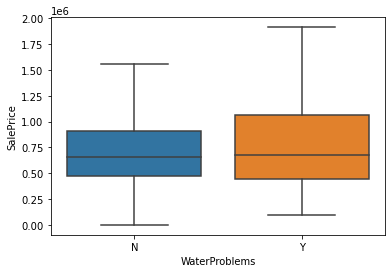

In [42]:
show_box(total_df, 'WaterProblems')

Water problems, homes with water problems seem to have higher prices, this makes no sense and due to uneven spread (only 70 in over 20,000) I will drop this column

In [43]:
for col in total_df.columns:
    print(col)
    print(total_df[col].value_counts())

Major_x
276760    79
814136    62
762570    53
510140    42
277060    42
          ..
773240     1
213300     1
313730     1
783580     1
082204     1
Name: Major_x, Length: 6579, dtype: int64
Minor_x
0040    354
0030    330
0020    322
0060    314
0010    298
       ... 
0413      1
9528      1
5517      1
0909      1
2076      1
Name: Minor_x, Length: 2453, dtype: int64
BldgNbr
1    18418
2       71
7        1
3        1
Name: BldgNbr, dtype: int64
NbrLivingUnits
1    18344
2      124
3       23
Name: NbrLivingUnits, dtype: int64
Address
                               14
18203  SE 272ND ST   98042      4
15425   2ND AVE NE  98155       4
3502   TROLL AVE N              3
418  S 37TH ST                  2
                               ..
1004  NW 127TH ST   98177       1
28836   164TH AVE SE  98042     1
12317   38TH AVE NE  98125      1
11728  SE 231ST PL   98031      1
16312   MAIN VIEW LN NE         1
Name: Address, Length: 18318, dtype: int64
BuildingNumber
         16
411      1

Name: BathHalfCount, dtype: int64
Bath3qtrCount
0    10457
1     6691
2     1228
3       98
4       12
5        3
6        2
Name: Bath3qtrCount, dtype: int64
BathFullCount
1    9125
2    7592
3    1363
0     217
4     169
5      21
6       3
7       1
Name: BathFullCount, dtype: int64
FpSingleStory
1    9272
0    8085
2     975
3     134
4      21
5       4
Name: FpSingleStory, dtype: int64
FpMultiStory
0    13207
1     4987
2      277
3       14
4        4
5        2
Name: FpMultiStory, dtype: int64
FpFreestanding
0    17276
1     1174
2       41
Name: FpFreestanding, dtype: int64
FpAdditional
0    15365
1     3007
2      112
3        7
Name: FpAdditional, dtype: int64
YrBuilt
2018    644
2019    371
1968    336
1977    334
1967    334
1978    316
2005    313
2004    310
2006    305
2007    301
1987    286
2003    281
1990    266
1962    258
1959    255
1979    255
2008    249
2015    249
1989    248
1969    240
1988    238
1955    231
2016    229
1954    220
2014    219
2001    219


                  1913
1                  578
4                  573
3                  569
2                  553
                  ... 
7 & 18               1
4 & 12 & 13          1
41 THRU 43           1
POR 1-2-2A           1
6     VAC AC 2       1
Name: PlatLot_x, Length: 1125, dtype: int64
PlatBlock_x
           10603
2           1089
1           1087
3            737
4            543
           ...  
2-1            1
125            1
32-3           1
8 A            1
32-3&          1
Name: PlatBlock_x, Length: 290, dtype: int64
Range
4     6399
5     5457
3     2968
6     2780
7      591
8      247
2       22
9       15
11       6
10       3
13       2
12       1
Name: Range, dtype: int64
Township
25    3956
24    3817
26    3485
23    2709
22    2198
21    2032
20     292
19       2
Name: Township, dtype: int64
Section
33    665
15    640
18    636
27    606
25    599
4     595
28    592
9     586
8     569
30    569
24    558
5     554
34    551
2     545
22    538
14    538
1

N    18491
Name: LandfillBuffer, dtype: int64
HundredYrFloodPlain
N    18491
Name: HundredYrFloodPlain, dtype: int64
SeismicHazard
N    18491
Name: SeismicHazard, dtype: int64
LandslideHazard
N    18491
Name: LandslideHazard, dtype: int64
SteepSlopeHazard
N    18491
Name: SteepSlopeHazard, dtype: int64
Stream
N    18491
Name: Stream, dtype: int64
Wetland
N    18491
Name: Wetland, dtype: int64
SpeciesOfConcern
N    18491
Name: SpeciesOfConcern, dtype: int64
SensitiveAreaTract
N    18491
Name: SensitiveAreaTract, dtype: int64
WaterProblems
N    18442
Y       49
Name: WaterProblems, dtype: int64
TranspConcurrency
N    18489
Y        2
Name: TranspConcurrency, dtype: int64
OtherProblems
N    18434
Y       57
Name: OtherProblems, dtype: int64
ExciseTaxNbr
3028365    2
2991068    1
3006495    1
3013128    1
3014855    1
          ..
2986746    1
2977552    1
2984750    1
3016538    1
2983211    1
Name: ExciseTaxNbr, Length: 18490, dtype: int64
Major
276760    79
814136    62
762570    53
510

<AxesSubplot:xlabel='ViewUtilization', ylabel='SalePrice'>

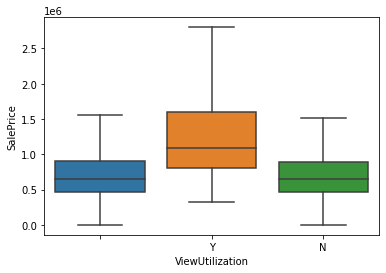

In [44]:
show_box(total_df, 'ViewUtilization')

Another feature worth keeping, although I will assume a blank entry is N.

<AxesSubplot:xlabel='ViewUtilization', ylabel='SalePrice'>

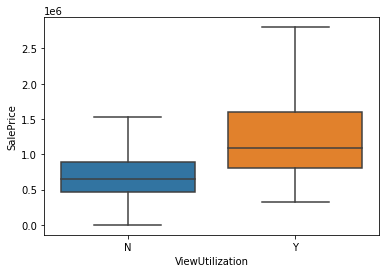

In [45]:
replace_val(total_df, 'ViewUtilization', ' ', 'N')

show_box(total_df, 'ViewUtilization')

That's better. Now I think all the columns worth keeping have been highlighted, its time to drop the rest, keeping some that I could be useful at some point - I don't know what I don't know yet!

In [46]:
cols_to_drop = ['Fraction','BldgGradeVar','AddnlCost', 'Unnamed: 0', 'Major_y', 'Minor_y', 'PropName', 'PlatName',\
               'PlatLot_x', 'PlatBlock_x', 'Range', 'SpecArea', 'SubArea', 'SpecSubArea', 'LevyCode', 'CurrentZoning',\
               'HBUAsIfVacant', 'HBUAsImproved', 'PresentUse','WaterSystem', 'SewerSystem', 'RestrictiveSzShape',\
               'PcntUnusable', 'WfntBank','WfntPoorQuality', 'WfntRestrictedAccess', 'WfntAccessRights',\
                'WfntProximityInfluence', 'TidelandShoreland','LotDepthFactor', 'AirportNoise',\
                'NbrBldgSites', 'Contamination', 'DNRLease','AdjacentGolfFairway', 'HistoricSite',\
                'CurrentUseDesignation', 'NativeGrowthProtEsmt', 'OtherDesignation', 'DeedRestrictions',\
                'DevelopmentRightsPurch', 'CoalMineHazard', 'CriticalDrainage','ErosionHazard', 'LandfillBuffer', \
                'HundredYrFloodPlain', 'SeismicHazard', 'LandslideHazard','SteepSlopeHazard','Stream', 'Wetland',\
                'SpeciesOfConcern', 'SensitiveAreaTract', 'WaterProblems', 'TranspConcurrency', 'OtherProblems','Volume','Page',\
                'PlatNbr', 'PlatType','PlatLot_y', 'PlatBlock_y', 'SellerName', 'BuyerName', 'PrincipalUse','SaleInstrument',\
                'AFForestLand', 'AFCurrentUseLand', 'AFNonProfitUse', 'AFHistoricProperty', 'SaleReason', \
               'NbrLivingUnits', 'SqFtUnfinFull', 'SqFtUnfinHalf','FpSingleStory','FpMultiStory','FpFreestanding','FpAdditional',\
               'PcntComplete','Obsolescence','PcntNetCondition', 'PropType', 'Unbuildable','StreetSurface', 'ExciseTaxNbr','Major',\
                'Minor', 'RecordingNbr', 'PropertyType', 'PropertyClass', 'Date']

In [47]:
total_df.drop(columns=cols_to_drop, inplace=True)

lets take a look at the new dataframe

In [48]:
total_df.head()

,Major_x,Minor_x,BldgNbr,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,id,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,Topography,InadequateParking,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,TrafficNoise,PowerLines,OtherNuisances,AdjacentGreenbelt,Easements,DocumentDate,SalePrice,SaleWarning,address
10,010050,0380,1,2435 S 354TH ST 98003,2435,S,354TH,ST,,98003,1,7,1480,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,N,3,0,0,2,1994,0,5,0100500380,21,28,NE,55,KING COUNTY,6446,4,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,N,N,12/12/2019,445000,,"2435 S 354TH ST , KING COUNTY, WA, USA"
11,010050,0380,1,2435 S 354TH ST 98003,2435,S,354TH,ST,,98003,1,7,1480,0,0,0,1480,0,0,0,0,440,,80,0,120,5,2,0,N,3,0,0,2,1994,0,5,0100500380,21,28,NE,55,KING COUNTY,6446,4,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,N,N,08/16/2019,311000,26,"2435 S 354TH ST , KING COUNTY, WA, USA"
17,017900,0315,1,12254 43RD AVE S 98178,12254,,43RD,AVE,S,98178,1,5,550,0,0,0,550,0,0,0,0,0,,0,0,0,1,1,0,N,2,0,1,0,1942,0,3,0179000315,23,10,SE,24,TUKWILA,4000,4,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,N,N,12/05/2019,188500,,"12254 43RD AVE S, TUKWILA, WA, USA"
21,018800,0095,1,1602 LAKEVIEW BLVD E 98102,1602,,LAKEVIEW,BLVD,E,98102,2,9,660,0,595,0,1540,380,285,8,0,0,Y,0,0,155,1,3,0,Y,3,1,1,1,1984,0,3,0188000095,25,20,SE,13,SEATTLE,3117,4,1,0,0,0,0,0,0,0,0,0,0,0,0,0,3,N,N,N,N,08/30/2019,730000,,"1602 LAKEVIEW BLVD E, SEATTLE, WA, USA"
28,019110,0310,1,4520 88TH AVE SE 98040,4520,,88TH,AVE,SE,98040,1,8,1390,0,0,0,2780,1390,1390,7,0,0,Y,0,0,100,5,2,0,N,6,0,1,1,1967,0,3,0191100310,24,18,SW,34,MERCER ISLAND,9525,4,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,N,N,N,N,10/01/2019,1055700,,"4520 88TH AVE SE, MERCER ISLAND, WA, USA"


Ok, it is starting to take shape, I want to transform the yes no columns into ones and zeroes though for analysis.

In [49]:
cols_to_encode = ['PowerLines','OtherNuisances','AdjacentGreenbelt','Easements', 'DaylightBasement']
# lets check the value counts first

In [50]:
for col in cols_to_encode:
    total_df[col] = total_df[col].str.strip()
    print(total_df[col].value_counts())

N    18276
Y      215
Name: PowerLines, dtype: int64
N    17931
Y      560
Name: OtherNuisances, dtype: int64
N    17957
Y      534
Name: AdjacentGreenbelt, dtype: int64
N    18098
Y      393
Name: Easements, dtype: int64
N    7543
     6114
Y    4831
y       3
Name: DaylightBasement, dtype: int64


In [51]:
# clean columns so they are either Y or N
replace_val(total_df, 'DaylightBasement', '', 'N')
replace_val(total_df, 'DaylightBasement', 'y', 'Y')
for col in cols_to_encode:
    total_df[col] = total_df[col].str.strip()
    print(total_df[col].value_counts())

N    18276
Y      215
Name: PowerLines, dtype: int64
N    17931
Y      560
Name: OtherNuisances, dtype: int64
N    17957
Y      534
Name: AdjacentGreenbelt, dtype: int64
N    18098
Y      393
Name: Easements, dtype: int64
N    13657
Y     4834
Name: DaylightBasement, dtype: int64


In [52]:
# creating instance of labelencoder
labelencoder = LabelEncoder()
# Replacing Y/N with numerical
for col in cols_to_encode:
    total_df[col] = labelencoder.fit_transform(total_df[col])
    print(total_df[col].value_counts())

0    18276
1      215
Name: PowerLines, dtype: int64
0    17931
1      560
Name: OtherNuisances, dtype: int64
0    17957
1      534
Name: AdjacentGreenbelt, dtype: int64
0    18098
1      393
Name: Easements, dtype: int64
0    13657
1     4834
Name: DaylightBasement, dtype: int64


In [53]:
total_df['ViewUtilization'].value_counts()

N    18074
Y      417
Name: ViewUtilization, dtype: int64

In [54]:
total_df['ViewUtilization'] = labelencoder.fit_transform(total_df['ViewUtilization'])
total_df['ViewUtilization'].value_counts()

0    18074
1      417
Name: ViewUtilization, dtype: int64

In [55]:
total_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18491 entries, 10 to 251295
Data columns (total 68 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Major_x              18491 non-null  object
 1   Minor_x              18491 non-null  object
 2   BldgNbr              18491 non-null  object
 3   Address              18491 non-null  object
 4   BuildingNumber       18491 non-null  object
 5   DirectionPrefix      18477 non-null  object
 6   StreetName           18491 non-null  object
 7   StreetType           18491 non-null  object
 8   DirectionSuffix      18477 non-null  object
 9   ZipCode              16072 non-null  object
 10  Stories              18491 non-null  object
 11  BldgGrade            18491 non-null  object
 12  SqFt1stFloor         18491 non-null  object
 13  SqFtHalfFloor        18491 non-null  object
 14  SqFt2ndFloor         18491 non-null  object
 15  SqFtUpperFloor       18491 non-null  object
 16  Sq

I still need to convert alot of these columns before they will be usable in a model. 

In [56]:
for col in total_df.columns:
    print(total_df[col].value_counts())

276760    79
814136    62
762570    53
510140    42
277060    42
          ..
773240     1
213300     1
313730     1
783580     1
082204     1
Name: Major_x, Length: 6579, dtype: int64
0040    354
0030    330
0020    322
0060    314
0010    298
       ... 
0413      1
9528      1
5517      1
0909      1
2076      1
Name: Minor_x, Length: 2453, dtype: int64
1    18418
2       71
7        1
3        1
Name: BldgNbr, dtype: int64
                               14
18203  SE 272ND ST   98042      4
15425   2ND AVE NE  98155       4
3502   TROLL AVE N              3
418  S 37TH ST                  2
                               ..
1004  NW 127TH ST   98177       1
28836   164TH AVE SE  98042     1
12317   38TH AVE NE  98125      1
11728  SE 231ST PL   98031      1
16312   MAIN VIEW LN NE         1
Name: Address, Length: 18318, dtype: int64
         16
411      16
415      15
306      13
115      12
         ..
12331     1
22030     1
11508     1
47211     1
23733     1
Name: BuildingNumber

5000     286
6000     244
7200     233
4000     225
8400     104
        ... 
37403      1
44460      1
6871       1
19836      1
25616      1
Name: SqFtLot, Length: 8919, dtype: int64
4    17332
3     1121
1       18
5       11
0        7
2        2
Name: Access, dtype: int64
0    17002
1     1489
Name: Topography, dtype: int64
2    11478
0     6995
1       18
Name: InadequateParking, dtype: int64
0    18326
2       79
3       67
4       19
Name: MtRainier, dtype: int64
0    18076
2      248
3      112
4       55
Name: Olympics, dtype: int64
0    17955
2      363
3      132
4       41
Name: Cascades, dtype: int64
0    16678
2     1114
3      487
4      212
Name: Territorial, dtype: int64
0    18318
2       96
3       52
4       25
Name: SeattleSkyline, dtype: int64
0    17983
1      202
2      125
3      114
4       67
Name: PugetSound, dtype: int64
0    17980
1      176
2      135
3      113
4       87
Name: LakeWashington, dtype: int64
0    18383
1       32
2       28
4       28
3  

In [57]:
cols_to_int = ['SqFt1stFloor', 'SqFtHalfFloor', 'SqFt2ndFloor', 'SqFtUpperFloor', 'SqFtTotLiving', 'SqFtTotBasement',\
                'SqFtFinBasement', 'FinBasementGrade', 'SqFtGarageBasement', 'SqFtGarageAttached', 'SqFtDeck', 'SqFtLot',\
               'Topography','WfntLocation', 'WfntFootage', 'MtRainier', 'Olympics', 'Cascades', 'Territorial', 'SeattleSkyline',\
               'PugetSound','LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView', 'YrBuilt']

In [58]:
total_df.columns

Index(['Major_x', 'Minor_x', 'BldgNbr', 'Address', 'BuildingNumber',
       'DirectionPrefix', 'StreetName', 'StreetType', 'DirectionSuffix',
       'ZipCode', 'Stories', 'BldgGrade', 'SqFt1stFloor', 'SqFtHalfFloor',
       'SqFt2ndFloor', 'SqFtUpperFloor', 'SqFtTotLiving', 'SqFtTotBasement',
       'SqFtFinBasement', 'FinBasementGrade', 'SqFtGarageBasement',
       'SqFtGarageAttached', 'DaylightBasement', 'SqFtOpenPorch',
       'SqFtEnclosedPorch', 'SqFtDeck', 'HeatSystem', 'HeatSource',
       'BrickStone', 'ViewUtilization', 'Bedrooms', 'BathHalfCount',
       'Bath3qtrCount', 'BathFullCount', 'YrBuilt', 'YrRenovated', 'Condition',
       'id', 'Township', 'Section', 'QuarterSection', 'Area', 'DistrictName',
       'SqFtLot', 'Access', 'Topography', 'InadequateParking', 'MtRainier',
       'Olympics', 'Cascades', 'Territorial', 'SeattleSkyline', 'PugetSound',
       'LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView',
       'WfntLocation', 'WfntFootage', 'Traffi

It is starting to take shape and resemble something that could be useable for analysis, however, remembering this data was imported as string. I will need to convert columns that should be integer.

In [59]:
# convert columns to integer type
for col in cols_to_int:
    total_df[col] = total_df[col].astype(int)

In [60]:
total_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18491 entries, 10 to 251295
Data columns (total 68 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Major_x              18491 non-null  object
 1   Minor_x              18491 non-null  object
 2   BldgNbr              18491 non-null  object
 3   Address              18491 non-null  object
 4   BuildingNumber       18491 non-null  object
 5   DirectionPrefix      18477 non-null  object
 6   StreetName           18491 non-null  object
 7   StreetType           18491 non-null  object
 8   DirectionSuffix      18477 non-null  object
 9   ZipCode              16072 non-null  object
 10  Stories              18491 non-null  object
 11  BldgGrade            18491 non-null  object
 12  SqFt1stFloor         18491 non-null  int32 
 13  SqFtHalfFloor        18491 non-null  int32 
 14  SqFt2ndFloor         18491 non-null  int32 
 15  SqFtUpperFloor       18491 non-null  int32 
 16  Sq

In [61]:
#check for null values
total_df.isna().sum()

Major_x                   0
Minor_x                   0
BldgNbr                   0
Address                   0
BuildingNumber            0
DirectionPrefix          14
StreetName                0
StreetType                0
DirectionSuffix          14
ZipCode                2419
Stories                   0
BldgGrade                 0
SqFt1stFloor              0
SqFtHalfFloor             0
SqFt2ndFloor              0
SqFtUpperFloor            0
SqFtTotLiving             0
SqFtTotBasement           0
SqFtFinBasement           0
FinBasementGrade          0
SqFtGarageBasement        0
SqFtGarageAttached        0
DaylightBasement          0
SqFtOpenPorch             0
SqFtEnclosedPorch         0
SqFtDeck                  0
HeatSystem                0
HeatSource                0
BrickStone                0
ViewUtilization           0
Bedrooms                  0
BathHalfCount             0
Bath3qtrCount             0
BathFullCount             0
YrBuilt                   0
YrRenovated         

In [62]:
len(total_df)

18491

In [63]:
# checking duplicates where only the price has changed, if it has changed and nothing else has then this isn't useful and 
# one of them should be dropped
columns_check_duplicates = ['Major_x', 'Minor_x', 'BldgNbr', 'Address', 'BuildingNumber',
       'DirectionPrefix', 'StreetName', 'StreetType', 'DirectionSuffix',
       'ZipCode', 'Stories', 'BldgGrade', 'SqFt1stFloor', 'SqFtHalfFloor',
       'SqFt2ndFloor', 'SqFtUpperFloor', 'SqFtTotLiving', 'SqFtTotBasement',
       'SqFtFinBasement', 'FinBasementGrade', 'SqFtGarageBasement',
       'SqFtGarageAttached', 'DaylightBasement', 'SqFtOpenPorch',
       'SqFtEnclosedPorch', 'SqFtDeck', 'HeatSystem', 'HeatSource',
       'BrickStone', 'ViewUtilization', 'Bedrooms', 'BathHalfCount',
       'Bath3qtrCount', 'BathFullCount', 'YrBuilt', 'YrRenovated', 'Condition',
       'id', 'Township', 'Section', 'QuarterSection', 'Area', 'DistrictName',
       'SqFtLot', 'Access', 'Topography', 'InadequateParking', 'MtRainier',
       'Olympics', 'Cascades', 'Territorial', 'SeattleSkyline', 'PugetSound',
       'LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView',
       'WfntLocation', 'WfntFootage', 'TrafficNoise', 'PowerLines',
       'OtherNuisances', 'AdjacentGreenbelt', 'Easements', 'DocumentDate','SaleWarning', 'address']

In [64]:
# removing duplicates where only price has changed. keeping the highest value
total_df[total_df.sort_values('SalePrice').duplicated(subset=columns_check_duplicates, keep=False)]


<ipython-input-64-7c07cd8313d9>:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  total_df[total_df.sort_values('SalePrice').duplicated(subset=columns_check_duplicates, keep=False)]


,Major_x,Minor_x,BldgNbr,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,id,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,Topography,InadequateParking,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,WfntFootage,TrafficNoise,PowerLines,OtherNuisances,AdjacentGreenbelt,Easements,DocumentDate,SalePrice,SaleWarning,address
59507,312206,9048,1,18203 SE 272ND ST 98042,18203,SE,272ND,ST,,98042,1.5,6,970,420,0,0,1390,0,0,0,0,0,0,200,0,230,4,3,0,0,2,1,0,1,1946,0,3,3122069048,22,31,NW,56,KING COUNTY,45396,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,06/18/2019,1500,,"18203 SE 272ND ST , KING COUNTY, WA, USA"
59508,312206,9048,1,18203 SE 272ND ST 98042,18203,SE,272ND,ST,,98042,1.5,6,970,420,0,0,1390,0,0,0,0,0,0,200,0,230,4,3,0,0,2,1,0,1,1946,0,3,3122069048,22,31,NW,56,KING COUNTY,45396,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,06/18/2019,3600,,"18203 SE 272ND ST , KING COUNTY, WA, USA"
59509,312206,9048,1,18203 SE 272ND ST 98042,18203,SE,272ND,ST,,98042,1.5,6,970,420,0,0,1390,0,0,0,0,0,0,200,0,230,4,3,0,0,2,1,0,1,1946,0,3,3122069048,22,31,NW,56,KING COUNTY,45396,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,06/18/2019,35484,,"18203 SE 272ND ST , KING COUNTY, WA, USA"
183159,781280,0105,1,7469 S 116TH ST 98178,7469,S,116TH,ST,,98178,1,6,790,0,0,0,790,0,0,0,0,0,0,0,0,0,5,1,0,0,2,0,0,1,1944,0,3,7812800105,23,12,NW,25,KING COUNTY,7905,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,06/25/2019,380000,,"7469 S 116TH ST , KING COUNTY, WA, USA"
183160,781280,0105,1,7469 S 116TH ST 98178,7469,S,116TH,ST,,98178,1,6,790,0,0,0,790,0,0,0,0,0,0,0,0,0,5,1,0,0,2,0,0,1,1944,0,3,7812800105,23,12,NW,25,KING COUNTY,7905,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,06/25/2019,154000,,"7469 S 116TH ST , KING COUNTY, WA, USA"
203156,927420,3841,1,2008 A CALIFORNIA AVE SW,2008,,CALIFORNIA,AVE,SW,NaN,2,8,910,0,920,0,2340,890,510,7,380,0,0,60,0,0,5,2,0,1,3,1,0,3,2007,0,3,9274203841,24,11,NE,16,SEATTLE,2077,3,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,09/16/2019,872000,,"2008 CALIFORNIA AVE SW, SEATTLE, WA, USA"
203158,927420,3841,1,2008 A CALIFORNIA AVE SW,2008,,CALIFORNIA,AVE,SW,NaN,2,8,910,0,920,0,2340,890,510,7,380,0,0,60,0,0,5,2,0,1,3,1,0,3,2007,0,3,9274203841,24,11,NE,16,SEATTLE,2077,3,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,09/16/2019,875000,,"2008 CALIFORNIA AVE SW, SEATTLE, WA, USA"


In [65]:
# remove these duplicates so only the highest price is kept.
total_df = total_df.sort_values('SalePrice')
total_df.drop_duplicates(subset=columns_check_duplicates, keep='last', inplace=True)


appears to be a lot of zip codes missing, there may be a way to find these from the Address column

In [66]:
# lets make the SaleWarning column more user friendly
total_df.SaleWarning.value_counts()    


               17376
15               242
26               201
40                99
41                93
10                51
15 51             49
15 46             45
51                43
46                38
15 26             25
12                17
56                16
18                14
15 40             13
54                13
15 56              9
12 15              9
34                 9
10 15              8
24                 6
10 56              6
35                 6
5 51               5
29                 5
49                 4
15 26 46           4
18 51              4
15 36 56           4
15 24              3
10 12              3
10 29              3
13 15              2
60                 2
18 22              2
15 36              2
15 46 51           2
26 46              2
10 15 56           2
13                 2
15 18              2
30                 2
7                  1
38                 1
45                 1
7 20               1
10 15 34           1
3 26         

In [67]:
len(total_df[total_df['SaleWarning']== ' '])

17376

In [68]:
total_df.loc[total_df['SaleWarning']!= ' ', 'SaleWarning'] = 1
total_df.loc[total_df['SaleWarning'] == ' ', 'SaleWarning'] = 0
total_df.SaleWarning.value_counts()  

0    17376
1     1111
Name: SaleWarning, dtype: int64

Now it is time to map the columns that have references that are related to in the look up table provided. Replacing these numbers with their actual values will make the values easier to interpret when it comes to making them dummy variables 

In [69]:
# convert heat system column as per values in lookup table
heating_dict = get_dict(108, lookup_df)
total_df.HeatSystem = total_df.HeatSystem.str.strip().astype(int).map(heating_dict)
total_df.HeatSystem.value_counts()

Forced Air    14392
Heat Pump      1595
Elec BB        1150
Floor-Wall      565
Hot Water       461
Radiant         258
Gravity          38
Other            11
Name: HeatSystem, dtype: int64

In [70]:
heatsource_dict = get_dict(84, lookup_df)
total_df.HeatSource = total_df.HeatSource.str.strip().astype(int).map(heatsource_dict)
total_df.HeatSource.value_counts()

Gas                  13352
Electricity           3257
Oil                   1792
Gas/Solar               39
Other                   17
Electricity/Solar       11
Oil/Solar                3
Name: HeatSource, dtype: int64

lets review the status of the df now a lot has changed

In [71]:
total_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18487 entries, 62686 to 153622
Data columns (total 68 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   Major_x              18487 non-null  object
 1   Minor_x              18487 non-null  object
 2   BldgNbr              18487 non-null  object
 3   Address              18487 non-null  object
 4   BuildingNumber       18487 non-null  object
 5   DirectionPrefix      18473 non-null  object
 6   StreetName           18487 non-null  object
 7   StreetType           18487 non-null  object
 8   DirectionSuffix      18473 non-null  object
 9   ZipCode              16069 non-null  object
 10  Stories              18487 non-null  object
 11  BldgGrade            18487 non-null  object
 12  SqFt1stFloor         18487 non-null  int32 
 13  SqFtHalfFloor        18487 non-null  int32 
 14  SqFt2ndFloor         18487 non-null  int32 
 15  SqFtUpperFloor       18487 non-null  int32 
 16 

In [72]:
for col in total_df.columns:
    print('\n')
    print(total_df[col].value_counts())
    print('\n')



276760    79
814136    62
762570    53
277060    42
510140    42
          ..
814200     1
219160     1
405080     1
177423     1
082204     1
Name: Major_x, Length: 6579, dtype: int64




0040    354
0030    330
0020    322
0060    314
0010    298
       ... 
1358      1
9461      1
3179      1
2652      1
1374      1
Name: Minor_x, Length: 2453, dtype: int64




1    18414
2       71
7        1
3        1
Name: BldgNbr, dtype: int64




                               14
15425   2ND AVE NE  98155       4
3502   TROLL AVE N              3
19613   138TH AVE SE  98058     2
7501   33RD AVE NE  98115       2
                               ..
28836   164TH AVE SE  98042     1
35182  NE 14TH ST   98014       1
12317   38TH AVE NE  98125      1
11728  SE 231ST PL   98031      1
16312   MAIN VIEW LN NE         1
Name: Address, Length: 18318, dtype: int64




411      16
         16
415      15
306      13
115      12
         ..
40425     1
5622      1
8231      1
15141     1
23733     1
Na

1972202382    3
1545806240    2
0269400100    2
5550300030    2
1330290140    2
             ..
4045700615    1
3066200160    1
3023000010    1
7519001650    1
4027700795    1
Name: id, Length: 18336, dtype: int64




25    3956
24    3816
26    3485
23    2708
22    2196
21    2032
20     292
19       2
Name: Township, dtype: int64




33    665
15    640
18    636
27    606
25    599
4     595
28    592
9     586
8     569
30    569
24    558
5     554
34    551
2     545
22    538
14    538
10    535
21    533
11    531
13    523
19    513
23    505
26    479
1     478
35    460
3     460
29    459
12    445
32    439
17    438
6     435
7     410
36    403
31    389
20    369
16    342
Name: Section, dtype: int64




SW    4652
NE    4647
NW    4601
SE    4587
Name: QuarterSection, dtype: int64




56     396
35     361
53     359
75     356
69     351
6      335
37     330
62     302
32     296
38     288
77     288
15     286
61     278
93     278
86     269
19     269
28     269

some more tidying required. 

In [73]:
# convert wfntlocation to binary column
total_df.loc[total_df['WfntLocation']!= 0, 'WfntLocation'] = 1
total_df.WfntLocation.value_counts()


0    18192
1      295
Name: WfntLocation, dtype: int64

time to drop more columns

In [74]:
total_df.columns

Index(['Major_x', 'Minor_x', 'BldgNbr', 'Address', 'BuildingNumber',
       'DirectionPrefix', 'StreetName', 'StreetType', 'DirectionSuffix',
       'ZipCode', 'Stories', 'BldgGrade', 'SqFt1stFloor', 'SqFtHalfFloor',
       'SqFt2ndFloor', 'SqFtUpperFloor', 'SqFtTotLiving', 'SqFtTotBasement',
       'SqFtFinBasement', 'FinBasementGrade', 'SqFtGarageBasement',
       'SqFtGarageAttached', 'DaylightBasement', 'SqFtOpenPorch',
       'SqFtEnclosedPorch', 'SqFtDeck', 'HeatSystem', 'HeatSource',
       'BrickStone', 'ViewUtilization', 'Bedrooms', 'BathHalfCount',
       'Bath3qtrCount', 'BathFullCount', 'YrBuilt', 'YrRenovated', 'Condition',
       'id', 'Township', 'Section', 'QuarterSection', 'Area', 'DistrictName',
       'SqFtLot', 'Access', 'Topography', 'InadequateParking', 'MtRainier',
       'Olympics', 'Cascades', 'Territorial', 'SeattleSkyline', 'PugetSound',
       'LakeWashington', 'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView',
       'WfntLocation', 'WfntFootage', 'Traffi

In [75]:
more_drops = ['Major_x', 'Minor_x', 'BldgNbr', 'WfntFootage'] 
total_df.drop(columns=more_drops, inplace=True)


In [76]:
total_df['SqFtOpenPorch'] = total_df['SqFtOpenPorch'].str.strip().astype(int)
total_df['SqFtEnclosedPorch'] = total_df['SqFtEnclosedPorch'].str.strip().astype(int)

do access and inadequate parking, then make column for excellent view.

In [77]:
view_columns = ['MtRainier','Olympics', 'Cascades', 'Territorial', 'SeattleSkyline', 'PugetSound','LakeWashington',\
                'LakeSammamish', 'SmallLakeRiverCreek', 'OtherView']
       
total_df[(total_df['MtRainier']==4)| (total_df['Olympics']==4) | (total_df['Cascades']==4) | (total_df['Territorial']==4)\
        | (total_df['SeattleSkyline']==4) | (total_df['PugetSound']==4) | (total_df['LakeWashington']==4) |\
        (total_df['LakeSammamish']==4)|(total_df['SmallLakeRiverCreek']==4) | (total_df['OtherView']==4)]

,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,id,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,Topography,InadequateParking,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,TrafficNoise,PowerLines,OtherNuisances,AdjacentGreenbelt,Easements,DocumentDate,SalePrice,SaleWarning,address
7464,10831 SE LAKE RD 98004,10831,SE,LAKE,RD,,98004,2,10,2100,0,2010,0,4110,430,0,0,0,870,1,1300,0,420,Forced Air,Gas,0,0,3,0,1,3,1959,2002,4,0824059113,24,8,SE,92,BELLEVUE,34625,4,0,2,3,0,0,4,0,0,3,0,0,0,1,3,0,0,0,0,02/15/2019,16082,1,"10831 SE LAKE RD , BELLEVUE, WA, USA"
10233,11065 SE LAKE RD 98004,11065,SE,LAKE,RD,,98004,2,10,2520,0,1780,0,3000,0,0,0,0,980,0,0,0,360,Forced Air,Gas,0,0,4,2,2,1,1957,0,5,0824059116,24,8,SE,92,BELLEVUE,27400,4,0,2,3,0,0,4,0,0,3,0,0,0,1,3,0,0,0,0,03/20/2019,17435,1,"11065 SE LAKE RD , BELLEVUE, WA, USA"
137867,30726 270TH AVE SE 98010,30726,,270TH,AVE,SE,98010,1,4,670,0,0,0,670,0,0,0,0,0,0,0,0,280,Elec BB,Electricity,0,0,1,0,0,0,1952,0,4,4080800155,21,12,NE,57,KING COUNTY,15152,4,1,0,0,0,0,0,0,0,0,0,4,0,1,0,0,0,0,0,05/28/2019,65000,0,"30726 270TH AVE SE, KING COUNTY, WA, USA"
26556,11610 DOLPHIN POINT TRL SW 98070,11610,,DOLPHIN POINT,TRL,SW,98070,1.5,6,770,230,0,0,820,0,0,0,0,0,0,0,0,250,Elec BB,Electricity,0,0,2,0,0,1,1977,0,3,0823039029,23,8,NW,100,KING COUNTY,28098,5,1,2,4,0,2,4,0,4,0,0,0,0,1,0,0,0,0,0,01/18/2019,200000,1,"11610 DOLPHIN POINT TRL SW, KING COUNTY, W..."
109312,31117 E LAKE MORTON DR SE 98042,31117,E,LAKE MORTON,DR,SE,98042,2,7,990,0,420,0,2190,780,780,7,0,0,1,0,0,210,Forced Air,Oil,0,0,3,1,0,1,1958,0,5,4053200255,21,8,NW,58,KING COUNTY,18890,4,0,0,0,0,0,2,0,0,0,0,4,0,1,0,0,0,0,0,02/06/2019,201000,0,"31117 E LAKE MORTON DR SE, KING COUNTY, WA..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92854,7406 N MERCER WAY 98040,7406,N,MERCER,WAY,,98040,1,10,430,0,0,0,810,380,380,10,0,0,0,0,0,0,Forced Air,Gas,0,0,1,0,0,1,2008,0,3,5315100085,24,1,SW,34,MERCER ISLAND,21793,4,0,2,0,0,0,4,0,0,4,0,0,3,1,0,0,0,0,0,02/22/2019,7200000,0,"7406 N MERCER WAY , MERCER ISLAND, WA, USA"
207747,2237 EVERGREEN POINT RD 98039,2237,,EVERGREEN POINT,RD,,98039,2,12,1620,0,1620,0,4575,1335,1335,11,0,0,1,70,0,756,Forced Air,Gas,0,0,4,1,1,3,2000,0,3,9208900009,25,25,NW,33,MEDINA,34092,4,1,0,0,0,0,3,0,0,4,0,0,0,1,0,0,0,0,0,08/16/2019,8250000,0,"2237 EVERGREEN POINT RD , MEDINA, WA, USA"
242620,3054 E LAURELHURST DR NE 98105,3054,E,LAURELHURST,DR,NE,98105,2,13,2700,0,2450,0,6830,3140,1680,10,680,0,1,170,0,490,Hot Water,Gas,100,0,4,1,3,2,1928,0,5,4217402315,25,15,SE,46,SEATTLE,40463,4,1,2,3,0,3,3,0,0,4,0,0,0,1,0,0,0,0,0,09/25/2019,10580000,0,"3054 E LAURELHURST DR NE, SEATTLE, WA, USA"
250369,4601 91ST PL NE 98004,4601,,91ST,PL,NE,98004,2,13,3510,0,1730,0,6020,880,780,10,0,500,0,380,0,40,Forced Air,Gas,0,0,4,1,2,2,1925,1990,4,9808100030,25,18,SW,33,YARROW POINT,50243,4,0,0,0,0,0,2,0,0,4,0,0,0,1,0,0,0,0,0,08/01/2019,15425000,0,"4601 91ST PL NE, YARROW POINT, WA, USA"


In [78]:
total_df['excellent_view'] = 0

In [79]:
total_df.loc[(total_df['MtRainier']==4)| (total_df['Olympics']==4) | (total_df['Cascades']==4) | (total_df['Territorial']==4)\
        | (total_df['SeattleSkyline']==4) | (total_df['PugetSound']==4) | (total_df['LakeWashington']==4) |\
        (total_df['LakeSammamish']==4)|(total_df['SmallLakeRiverCreek']==4) | (total_df['OtherView']==4), 'excellent_view'] = 1

created a new column just for excellent views, I will now make the rest of the view columns binary. 

In [80]:
total_df.head()

,Address,BuildingNumber,DirectionPrefix,StreetName,StreetType,DirectionSuffix,ZipCode,Stories,BldgGrade,SqFt1stFloor,SqFtHalfFloor,SqFt2ndFloor,SqFtUpperFloor,SqFtTotLiving,SqFtTotBasement,SqFtFinBasement,FinBasementGrade,SqFtGarageBasement,SqFtGarageAttached,DaylightBasement,SqFtOpenPorch,SqFtEnclosedPorch,SqFtDeck,HeatSystem,HeatSource,BrickStone,ViewUtilization,Bedrooms,BathHalfCount,Bath3qtrCount,BathFullCount,YrBuilt,YrRenovated,Condition,id,Township,Section,QuarterSection,Area,DistrictName,SqFtLot,Access,Topography,InadequateParking,MtRainier,Olympics,Cascades,Territorial,SeattleSkyline,PugetSound,LakeWashington,LakeSammamish,SmallLakeRiverCreek,OtherView,WfntLocation,TrafficNoise,PowerLines,OtherNuisances,AdjacentGreenbelt,Easements,DocumentDate,SalePrice,SaleWarning,address,excellent_view
62686,17701 185TH AVE NE 98072,17701,,185TH,AVE,NE,98072,1,7,750,0,0,0,1500,750,750,7,0,0,1,0,0,520,Forced Air,Electricity,0,0,3,1,0,1,1977,0,5,1630700286,26,7,NW,36,KING COUNTY,14494,4,1,2,0,0,0,3,0,0,0,0,0,0,0,0,0,0,0,0,06/03/2019,10,0,"17701 185TH AVE NE, KING COUNTY, WA, USA",0
157183,9508 167TH AVE NE 98052,9508,,167TH,AVE,NE,98052,1,7,1290,0,0,0,1290,0,0,0,0,300,0,0,260,0,Elec BB,Electricity,0,0,3,0,0,2,1967,0,4,6138400450,25,1,NW,72,REDMOND,9687,4,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,06/08/2019,1000,1,"9508 167TH AVE NE, REDMOND, WA, USA",0
876,19361 61ST AVE NE 98028,19361,,61ST,AVE,NE,98028,2,7,1470,0,490,0,1960,0,0,0,0,310,0,0,0,160,Forced Air,Gas,0,0,3,0,1,2,1958,0,4,0226049046,26,2,SW,38,KENMORE,16183,4,0,2,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,08/01/2019,1500,1,"19361 61ST AVE NE, KENMORE, WA, USA",0
247014,15915 VASHON HWY SW 98070,15915,,VASHON,HWY,SW,98070,1,7,1330,0,0,0,1330,0,0,0,0,0,0,0,40,180,Floor-Wall,Oil,0,0,3,0,0,1,1950,0,4,1923039062,23,19,SE,100,KING COUNTY,35283,4,0,2,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,05/02/2019,1500,1,"15915 VASHON HWY SW, KING COUNTY, WA, USA",0
188918,10616 SW 133RD ST 98070,10616,SW,133RD,ST,,98070,1,6,480,0,0,0,480,0,0,0,0,0,0,0,0,0,Floor-Wall,Electricity,0,0,1,0,1,0,1991,0,3,1823039065,23,18,NE,100,KING COUNTY,37927,4,0,2,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,03/25/2019,1500,1,"10616 SW 133RD ST , KING COUNTY, WA, USA",0


In [81]:
for col in view_columns:
    total_df.loc[total_df[col]!= 0, col] = 1

In [82]:
total_df.Access.value_counts()

4    17329
3     1120
1       18
5       11
0        7
2        2
Name: Access, dtype: int64

In [83]:
access_dict = get_dict(55, lookup_df)
access_dict

{1: 'RESTRICTED',
 2: 'LEGAL/UNDEVELOPED',
 3: 'PRIVATE',
 4: 'PUBLIC',
 5: 'WALK IN'}

In [84]:
total_df.Access = total_df.Access.str.strip().astype(int).map(access_dict)

In [85]:
total_df.Access.value_counts()

PUBLIC               17329
PRIVATE               1120
RESTRICTED              18
WALK IN                 11
LEGAL/UNDEVELOPED        2
Name: Access, dtype: int64

In [86]:
total_df.InadequateParking.value_counts()

2    11477
0     6992
1       18
Name: InadequateParking, dtype: int64

I am going to make an assumption that since 2 represents aqequate parking that 0 and 1 will represent inadequate parking

In [87]:
replace_val(total_df, 'InadequateParking', '1', 0)
total_df.InadequateParking.value_counts()

2    11477
0     6992
0       18
Name: InadequateParking, dtype: int64

In [88]:
replace_val(total_df, 'InadequateParking', '0', 0)
replace_val(total_df, 'InadequateParking', '1', 0)
replace_val(total_df, 'InadequateParking', '2', 1)
total_df.InadequateParking.value_counts()

1    11477
0     7010
Name: InadequateParking, dtype: int64

I will now join the table I created to get latitude and longitude information

In [90]:
longslats_df = pd.read_csv('..\..\data/raw/longslats.csv', dtype='str')

In [91]:
longslats_df = longslats_df[['id', 'latitude', 'longitude']]

In [92]:
total_df.to_csv('pre-merge.csv')

In [93]:
total_df = total_df.merge(longslats_df, how='left', on='id')

In [94]:
total_df['latitude'] = total_df['latitude'].astype(float)
total_df['longitude'] = total_df['longitude'].astype(float)

In [95]:
total_df.isna().sum()

Address                   0
BuildingNumber            0
DirectionPrefix          14
StreetName                0
StreetType                0
DirectionSuffix          14
ZipCode                2441
Stories                   0
BldgGrade                 0
SqFt1stFloor              0
SqFtHalfFloor             0
SqFt2ndFloor              0
SqFtUpperFloor            0
SqFtTotLiving             0
SqFtTotBasement           0
SqFtFinBasement           0
FinBasementGrade          0
SqFtGarageBasement        0
SqFtGarageAttached        0
DaylightBasement          0
SqFtOpenPorch             0
SqFtEnclosedPorch         0
SqFtDeck                  0
HeatSystem               17
HeatSource               16
BrickStone                0
ViewUtilization           0
Bedrooms                  0
BathHalfCount             0
Bath3qtrCount             0
BathFullCount             0
YrBuilt                   0
YrRenovated               0
Condition                 0
id                        0
Township            

In [96]:
len(total_df)

18797

In [97]:
total_df.dropna(subset=['ZipCode'], inplace=True)

In [98]:
len(total_df)

16356

In [99]:
total_df.isna().sum()

Address                  0
BuildingNumber           0
DirectionPrefix          0
StreetName               0
StreetType               0
DirectionSuffix          0
ZipCode                  0
Stories                  0
BldgGrade                0
SqFt1stFloor             0
SqFtHalfFloor            0
SqFt2ndFloor             0
SqFtUpperFloor           0
SqFtTotLiving            0
SqFtTotBasement          0
SqFtFinBasement          0
FinBasementGrade         0
SqFtGarageBasement       0
SqFtGarageAttached       0
DaylightBasement         0
SqFtOpenPorch            0
SqFtEnclosedPorch        0
SqFtDeck                 0
HeatSystem              16
HeatSource              16
BrickStone               0
ViewUtilization          0
Bedrooms                 0
BathHalfCount            0
Bath3qtrCount            0
BathFullCount            0
YrBuilt                  0
YrRenovated              0
Condition                0
id                       0
Township                 0
Section                  0
Q

In [100]:
total_df.dropna(subset=['latitude', 'longitude', 'HeatSource', 'HeatSystem', 'Access'], inplace=True)

In [101]:
len(total_df)

16131

In [102]:
total_df.isna().sum()

Address                0
BuildingNumber         0
DirectionPrefix        0
StreetName             0
StreetType             0
DirectionSuffix        0
ZipCode                0
Stories                0
BldgGrade              0
SqFt1stFloor           0
SqFtHalfFloor          0
SqFt2ndFloor           0
SqFtUpperFloor         0
SqFtTotLiving          0
SqFtTotBasement        0
SqFtFinBasement        0
FinBasementGrade       0
SqFtGarageBasement     0
SqFtGarageAttached     0
DaylightBasement       0
SqFtOpenPorch          0
SqFtEnclosedPorch      0
SqFtDeck               0
HeatSystem             0
HeatSource             0
BrickStone             0
ViewUtilization        0
Bedrooms               0
BathHalfCount          0
Bath3qtrCount          0
BathFullCount          0
YrBuilt                0
YrRenovated            0
Condition              0
id                     0
Township               0
Section                0
QuarterSection         0
Area                   0
DistrictName           0


In [103]:
total_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16131 entries, 0 to 18796
Data columns (total 67 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Address              16131 non-null  object 
 1   BuildingNumber       16131 non-null  object 
 2   DirectionPrefix      16131 non-null  object 
 3   StreetName           16131 non-null  object 
 4   StreetType           16131 non-null  object 
 5   DirectionSuffix      16131 non-null  object 
 6   ZipCode              16131 non-null  object 
 7   Stories              16131 non-null  object 
 8   BldgGrade            16131 non-null  object 
 9   SqFt1stFloor         16131 non-null  int32  
 10  SqFtHalfFloor        16131 non-null  int32  
 11  SqFt2ndFloor         16131 non-null  int32  
 12  SqFtUpperFloor       16131 non-null  int32  
 13  SqFtTotLiving        16131 non-null  int32  
 14  SqFtTotBasement      16131 non-null  int32  
 15  SqFtFinBasement      16131 non-null 

In [104]:
#drop duplicates with same address and same price
total_df.drop_duplicates(subset=['Address', 'SalePrice'], keep='last', inplace=True)

In [105]:
#total_df.to_csv('cleaned_data.csv')

that was hard work, a lot of columns required attention but now its time to start modelling.
This data will require further cleaning iterations and feature engineering but this is a good starting point

In [106]:
#Create base map zoomed in to seattle
map3=folium.Map(location=[47.5837012,-122.3984634],  tiles=None, zoom_start=7)
folium.TileLayer('cartodbpositron', name='King County House Prices').add_to(map3)

#Make Marker Cluster Group layer
mcg = folium.plugins.MarkerCluster(control=False)
map3.add_child(mcg)

#Create layer of markers
#Set marker popups to display name and address of service
for row in total_df.iterrows():
    row_values=row[1]
    location=[row_values['latitude'], row_values['longitude']]
    popup=popup=('$' + str(row_values['SalePrice'])+'<br>'+'<br>'+ row_values['Address']+
                 '<br>'+'<br>'+row_values['DistrictName'])
    marker=folium.Marker(location=location, popup=popup, min_width=2000)
    marker.add_to(mcg)

#Add layer control
folium.LayerControl().add_to(map3)

map3